In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Function to check and install specific package versions
def install_package(package, version):
    try:
        # Check the current version
        current_version = __import__(package).__version__

        # Special handling for torch to check for version with CUDA suffix
        if package == "torch":
            if current_version.startswith(version):
                print(f"{package} version {version} is already installed.")
                return
        else:
            if current_version == version:
                print(f"{package} version {version} is already installed.")
                return

        print(f"Uninstalling {package} version {current_version}...")
        !pip uninstall -y {package}
        print(f"Installing {package} version {version}...")
        !pip install {package}=={version}

    except ImportError:
        print(f"{package} not installed. Installing {package} version {version}...")
        !pip install {package}=={version}

# Specify the packages and their desired versions
packages = {
    "pandas": "2.2.2",
    "numpy": "1.26.4",
    "scikit-learn": "1.6.0",
    "torch": "2.5.1",
    "joblib": "1.4.2",
    "matplotlib": "3.10.0"
}

# Check and install packages
for pkg, ver in packages.items():
    install_package(pkg, ver)

# Import the necessary libraries after ensuring correct versions
import pandas as pd
import numpy as np
import matplotlib as mpl  # Import matplotlib for version checking
import matplotlib.pyplot as plt
import torch
import joblib
import json
import torch.nn as nn
from sklearn import __version__ as sklearn_version  # Import sklearn version

# Verify the versions of the installed packages
print("pandas version:", pd.__version__)
print("numpy version:", np.__version__)
print("scikit-learn version:", sklearn_version)
print("torch version:", torch.__version__)
print("joblib version:", joblib.__version__)
print("matplotlib version:", mpl.__version__)
print("CUDA available:", torch.cuda.is_available())

pandas version 2.2.2 is already installed.
numpy version 1.26.4 is already installed.
scikit-learn not installed. Installing scikit-learn version 1.6.0...
torch version 2.5.1 is already installed.
joblib version 1.4.2 is already installed.
matplotlib version 3.10.0 is already installed.
pandas version: 2.2.2
numpy version: 1.26.4
scikit-learn version: 1.6.0
torch version: 2.5.1+cu124
joblib version: 1.4.2
matplotlib version: 3.10.0
CUDA available: False


In [ ]:
# DETREND_WINDOW_SIZE = 2
WINDOW_SIZE = 75
FEATURES_TO_DETREND = ['close', 'EMA_5', 'EMA_10', 'EMA_15', 'EMA_20']  #'open', 'high', 'low',
FEATURES_NOT_TO_DETREND = ['LONG_UPPER_SHADOW', 'LONG_LOWER_SHADOW', 'EMA_5_EMA_10', 'EMA_15_EMA_20', 'RSI', 'RSI_INT']
# FEATURES_NOT_TO_DETREND = ['RSI']
ALL_FEATURES = FEATURES_TO_DETREND + FEATURES_NOT_TO_DETREND
NUM_PREDICTIONS = 15
PREDICTION_LEN = 1   # Number of time steps to predict each time
PREDICTION_TIMESTEP_SPAN = 0
MIN_SHADOW_PROPORTION = 0.0001  # 0.0005

In [ ]:
# import requests
# import pytz
# from datetime import timedelta

# # Fetch JSON data from the URL
# headers = {
#     'User-Agent': 'Mozilla/5.0'
# }
# url = "https://query1.finance.yahoo.com/v7/finance/chart/spy?dataGranularity=1m&range=7d"
# response = requests.get(url, headers=headers)
# print(response.status_code)  # Should be 200 for a successful request
# json_data = response.json()

# # Extract relevant information from the JSON response
# timestamp = json_data['chart']['result'][0]['timestamp']
# open_prices = json_data['chart']['result'][0]['indicators']['quote'][0]['open']
# high_prices = json_data['chart']['result'][0]['indicators']['quote'][0]['high']
# low_prices = json_data['chart']['result'][0]['indicators']['quote'][0]['low']
# close_prices = json_data['chart']['result'][0]['indicators']['quote'][0]['close']

# # Create a DataFrame
# df = pd.DataFrame({
#     'timestamp': timestamp,
#     'open': open_prices,
#     'high': high_prices,
#     'low': low_prices,
#     'close': close_prices
# })

# # Drop rows where any of the indicators are NaN
# df = df.dropna(subset=['timestamp', 'open', 'high', 'low', 'close']).reset_index(drop=True)

# # Convert timestamp to datetime and set timezone to EST
# df['datetime'] = pd.to_datetime(df['timestamp'], unit='s').dt.tz_localize('UTC').dt.tz_convert('America/New_York')

# # Define trading day start and end times
# df['trading_day'] = df['datetime'].dt.floor('D')
# df['market_open'] = df['trading_day'] + pd.Timedelta(hours=9, minutes=30)  # 9:30 AM
# df['market_close'] = df['trading_day'] + pd.Timedelta(hours=16, minutes=0)  # 4:00 PM

# # Create a mask to filter out the unwanted time periods
# mask = ~((df['datetime'] < (df['market_open'] + pd.Timedelta(minutes=30))) |
#           (df['datetime'] > (df['market_close'] - pd.Timedelta(minutes=5))))  # For 3 minute interval: minutes=60

# df = df[mask].reset_index(drop=True)

# # Check for NaN values in the DataFrame
# if df.isna().any().any():
#     print("Error: NaN values found in calculations.")
#     problematic_rows = df[df.isna().any(axis=1)]
#     print(problematic_rows)  # Print only relevant columns
#     print('---')

# # Calculate EMA
# def calculate_ema(df, period):
#     return df['close'].ewm(span=period, adjust=False).mean()

# # Revised RSI calculation to uses EMA
# def calculate_rsi(df, period=7):
#     delta = df['close'].diff()

#     # Separate gains and losses
#     gains = delta.where(delta > 0, 0.0)
#     losses = -delta.where(delta < 0, 0.0)

#     # Calculate EMA multiplier
#     alpha = 2 / (period + 1)

#     # First averages (SMA)
#     first_avg_gain = gains.iloc[:period].mean() if period <= len(gains) else gains.mean()
#     first_avg_loss = losses.iloc[:period].mean() if period <= len(losses) else losses.mean()

#     # Initialize series
#     avg_gains = pd.Series(index=delta.index)
#     avg_losses = pd.Series(index=delta.index)

#     # Set first values
#     avg_gains.iloc[period-1] = first_avg_gain
#     avg_losses.iloc[period-1] = first_avg_loss

#     # Calculate EMA
#     for i in range(period, len(gains)):
#         avg_gains.iloc[i] = alpha * gains.iloc[i] + (1 - alpha) * avg_gains.iloc[i-1]
#         avg_losses.iloc[i] = alpha * losses.iloc[i] + (1 - alpha) * avg_losses.iloc[i-1]

#     rs = avg_gains / np.where(avg_losses == 0, 1e-10, avg_losses)
#     rsi = 100 - (100 / (1 + rs))

#     # Ensure RSI stays within bounds
#     rsi = np.clip(rsi, 0, 100)

#     return avg_gains, avg_losses, rsi

# # Append EMA to DataFrame
# df['EMA_5'] = calculate_ema(df, 5)
# df['EMA_10'] = calculate_ema(df, 10)
# df['EMA_15'] = calculate_ema(df, 15)
# df['EMA_20'] = calculate_ema(df, 20)

# # Calculate RSI and gain/loss
# df['Gain'], df['Loss'], df['RSI'] = calculate_rsi(df)

# # Drop the first 20 rows (EMA 20)
# df = df.iloc[20:].reset_index(drop=True)

# # Check for NaN values in the DataFrame
# if df.isna().any().any():
#     print("Error: NaN values found in calculations.")
#     problematic_rows = df[df.isna().any(axis=1)]
#     print(problematic_rows)  # Print only relevant columns

# # Drop rows where any of the indicators are NaN
# df = df.dropna(subset=['EMA_5', 'EMA_10', 'EMA_15', 'EMA_20', 'RSI']).reset_index(drop=True)

# # Transform RSI to Int values based on specified rules
# def transform_rsi_to_int(rsi):
#     if rsi >= 70:
#         return 1
#     elif rsi <= 30:
#         return -1
#     else:
#         return 0

# df['RSI_INT'] = df['RSI'].apply(transform_rsi_to_int)

# # Add EMA comparison columns
# df['EMA_5_EMA_10'] = (df['EMA_5'] > df['EMA_10']).astype(int)
# df['EMA_15_EMA_20'] = (df['EMA_15'] > df['EMA_20']).astype(int)

# # Calculate shadow lengths
# def calculate_shadow_fold(row):
#     # body_size = abs(row['open'] - row['close'])
#     min_body_threshold = row['close'] * MIN_SHADOW_PROPORTION

#     if row['open'] > row['close']:  # Bearish candle
#         upper_shadow = row['high'] - row['open']
#         lower_shadow = row['close'] - row['low']
#     else:  # Bullish candle
#         upper_shadow = row['high'] - row['close']
#         lower_shadow = row['open'] - row['low']

#     if upper_shadow < min_body_threshold:
#         upper_fold = 0
#     else:
#         upper_fold = upper_shadow / min_body_threshold

#     if lower_shadow < min_body_threshold:
#         lower_fold = 0
#     else:
#         lower_fold = lower_shadow / min_body_threshold

#     return upper_fold, lower_fold

# # Calculate shadow folds for each row
# shadow_folds = df.apply(calculate_shadow_fold, axis=1)
# upper_folds, lower_folds = zip(*shadow_folds)

# # Convert folds to categorical values
# def categorize_fold(fold):
#     if fold < 1:
#         return 0
#     return int(fold)

# df['LONG_UPPER_SHADOW'] = [categorize_fold(fold) for fold in upper_folds]
# df['LONG_LOWER_SHADOW'] = [categorize_fold(fold) for fold in lower_folds]

# # Create multiple DataFrames with different starting points
# EXTENDED_ITEMS_FOR_BACKTESTING_LEN = 60
# EXTRA_ONE_FOR_DIFF = 1
# STEP_SIZE = 10

# # Calculate how many complete windows we can create
# total_rows = len(df)
# max_start_idx = total_rows - (WINDOW_SIZE + EXTENDED_ITEMS_FOR_BACKTESTING_LEN + EXTRA_ONE_FOR_DIFF)

# count = 0
# for start_idx in range(0, max_start_idx + 1, STEP_SIZE):
#     end_idx = start_idx + WINDOW_SIZE + EXTENDED_ITEMS_FOR_BACKTESTING_LEN + EXTRA_ONE_FOR_DIFF

#     # Ensure start_idx and end_idx fall on the same trading day
#     if df['trading_day'].iloc[start_idx] == df['trading_day'].iloc[end_idx - 1]:
#         temp_df = df.iloc[start_idx:end_idx].reset_index(drop=True)
#         # Drop the specified columns from temp_df
#         temp_df = temp_df.drop(columns=['datetime', 'trading_day', 'market_open', 'market_close'])

#         # Generate Unix timestamp from the first 'timestamp' in temp_df
#         first_timestamp = pd.to_datetime(temp_df['timestamp'], unit='s').iloc[0]
#         # Create a string formatted timestamp
#         timestamp_str = first_timestamp.strftime('%d%b%Y_%H%M')

#         json_string = temp_df.to_dict(orient='records')

#         # Save the JSON string to a file
#         filename = f'/content/drive/MyDrive/Colab Notebooks/futures.ai/backtest/historical_{WINDOW_SIZE + EXTENDED_ITEMS_FOR_BACKTESTING_LEN + EXTRA_ONE_FOR_DIFF}_with_extended_{EXTENDED_ITEMS_FOR_BACKTESTING_LEN}_{timestamp_str}.json'
#         with open(filename, 'w') as json_file:
#             json.dump(json_string, json_file)
#         count = count + 1
# print(count)

200
167


In [ ]:
# # Convert JSON file to DataFrame
# backtest_df = pd.read_json('/content/drive/MyDrive/Colab Notebooks/futures.ai/backtest/historical_111_with_extended_60_31Jan2025_1855.json')

# print(backtest_df)

              timestamp        open        high         low       close  \
0   2025-01-31 18:55:00  605.559998  605.789978  605.450012  605.729980   
1   2025-01-31 18:56:00  605.719971  605.890015  605.679993  605.770020   
2   2025-01-31 18:57:00  605.799988  605.799988  605.469971  605.630005   
3   2025-01-31 18:58:00  605.599976  605.599976  605.270020  605.304993   
4   2025-01-31 18:59:00  605.289978  605.479919  605.130127  605.385010   
..                  ...         ...         ...         ...         ...   
106 2025-01-31 20:41:00  601.280029  601.650024  601.169983  601.520020   
107 2025-01-31 20:42:00  601.500000  601.869995  601.440002  601.575012   
108 2025-01-31 20:43:00  601.570007  601.620117  601.049988  601.119995   
109 2025-01-31 20:44:00  601.140015  601.460022  601.140015  601.229980   
110 2025-01-31 20:45:00  601.219971  601.690002  601.219971  601.489990   

          EMA_5      EMA_10      EMA_15      EMA_20      Gain      Loss  \
0    605.679731  605.775

In [ ]:
class FixedRangeScaler:
    def __init__(self, feature_range=(0, 1), input_range=(0, 100)):
        self.feature_range = feature_range
        self.input_range = input_range

    def transform(self, X):
        X_std = (X - self.input_range[0]) / (self.input_range[1] - self.input_range[0])
        X_scaled = X_std * (self.feature_range[1] - self.feature_range[0]) + self.feature_range[0]
        return X_scaled

    def inverse_transform(self, X):
        X_std = (X - self.feature_range[0]) / (self.feature_range[1] - self.feature_range[0])
        X_original = X_std * (self.input_range[1] - self.input_range[0]) + self.input_range[0]
        return X_original

# Load the saved scalers
dynamic_scaler = joblib.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/dynamic_scaler.pkl')
long_upper_shadow_dynamic_scaler = joblib.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/long_upper_shadow_dynamic_scaler.pkl')
long_lower_shadow_dynamic_scaler = joblib.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/long_lower_shadow_dynamic_scaler.pkl')
rsi_scaler = joblib.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/rsi_scaler.pkl')
rsi_int_scaler = joblib.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/rsi_int_scaler.pkl')
close_dynamic_scaler = joblib.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/close_dynamic_scaler.pkl')

class ANN(nn.Module):
    def __init__(self):
        super(ANN, self).__init__()
        self.input_size = WINDOW_SIZE * len(ALL_FEATURES)
        # self.output_size = len(ALL_FEATURES) * PREDICTION_LEN # All normalized features
        self.output_size = PREDICTION_LEN # Only the 'close' price

        self.model = nn.Sequential(
            nn.Flatten(),

            nn.Linear(self.input_size, 256),
            # nn.BatchNorm1d(256),
            nn.ReLU(),
            # nn.Dropout(0.2),
            # nn.Linear(256, self.output_size),

            nn.Linear(256, 128),
            # nn.BatchNorm1d(128),
            nn.ReLU(),
            # nn.Dropout(0.2),
            nn.Linear(128, self.output_size),

            # nn.Linear(128, 64),
            # nn.BatchNorm1d(64),
            # nn.ReLU(),
            # nn.Dropout(0.2),
            # nn.Linear(64, self.output_size),

            nn.Sigmoid()
        )

    def forward(self, x):
        batch_size = x.size(0)
        output = self.model(x.reshape(batch_size, -1))
        return output.view(batch_size, PREDICTION_LEN, -1)

# Load the trained model
model = ANN()
if torch.cuda.is_available():
    model.load_state_dict(torch.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/best_model_cv.pth', weights_only=True))
else:
    model.load_state_dict(torch.load('/content/drive/MyDrive/Colab Notebooks/futures.ai/best_model_cv.pth', map_location=torch.device('cpu'), weights_only=True))
model.eval()  # Set the model to evaluation mode

# Preprocess the new input JSON file
def preprocess_new_data(df):
    # De-trend the features
    for feature in FEATURES_TO_DETREND:
        # SMA for de-trending
        # df[f'{feature}_trend'] = df[feature].rolling(window=DETREND_WINDOW_SIZE).mean()
        # df[f'{feature}_detrended'] = df[feature] - df[f'{feature}_trend']

        # Differencing for de-trending
        df[f'{feature}_detrended'] = df[feature].diff()  # Calculate the difference from the previous value
    df = df.dropna()    # Drop the first row which will be NaN due to differencing or drop NaN values created by rolling mean

    # Use the saved scalers to transform the detrended data
    # (The same minimum and maximum values from the training dataset to normalize the prediction dataset)
    detrended_features = df[[f'{feature}_detrended' for feature in FEATURES_TO_DETREND]].values
    normalized_features = dynamic_scaler.transform(detrended_features)

    df = df.copy()  # Create a copy to avoid SettingWithCopyWarning
    # Assign normalized values back to DataFrame
    for i, feature in enumerate(FEATURES_TO_DETREND):
        df[f'{feature}_normalized'] = normalized_features[:, i]
    # Normalize separately
    df['LONG_UPPER_SHADOW_normalized'] = long_upper_shadow_dynamic_scaler.transform(df['LONG_UPPER_SHADOW'].values.reshape(-1, 1))
    df['LONG_LOWER_SHADOW_normalized'] = long_lower_shadow_dynamic_scaler.transform(df['LONG_LOWER_SHADOW'].values.reshape(-1, 1))
    df['EMA_5_EMA_10_normalized'] = df['EMA_5_EMA_10']
    df['EMA_15_EMA_20_normalized'] = df['EMA_15_EMA_20']
    df['RSI_normalized'] = rsi_scaler.transform(df['RSI'].values.reshape(-1, 1))
    df['RSI_INT_normalized'] = rsi_int_scaler.transform(df['RSI_INT'].values.reshape(-1, 1))

    return df

# Create a dataset for predictions based on the new data
def create_prediction_dataset(new_df):
    last_sequence = new_df[[f'{feature}_normalized' for feature in ALL_FEATURES]].iloc[-WINDOW_SIZE:].values
    return torch.tensor(last_sequence, dtype=torch.float32).unsqueeze(0)  # Add batch dimension

# Modified the EMA and RSI calculations since they were originally designed for actual price values rather than detrended values.
# When working with detrended data, the traditional interpretations of EMA and RSI need to be adjusted because:
# - Detrended values oscillate around zero
# - The magnitude of changes is different from actual prices
# - Negative values are common in detrended data

def calculate_ema_for_sequence(values, period):
    alpha = 2 / (period + 1)
    values = np.array(values)
    res = np.zeros_like(values)
    res[0] = values[0]

    # Use the same ewm formula as pandas
    for i in range(1, len(values)):
        res[i] = alpha * values[i] + (1 - alpha) * res[i-1]

    return res[-1]  # Return the last EMA value

def calculate_rsi_for_sequence(diff_values, period=7):
    values = np.array(diff_values)

    # Calculate price changes
    changes = np.diff(values)
    changes = np.append(0, changes)  # Add 0 at the beginning to maintain length

    # Separate gains and losses
    # gains = np.where(changes > 0, changes, 0)
    # losses = np.where(changes < 0, -changes, 0)
    # For detrended data, we compare to zero instead of previous value
    gains = np.where(values > 0, values, 0)
    losses = np.where(values < 0, -values, 0)

    # Calculate EMA multiplier
    alpha = 2 / (period + 1)

    # Initialize average gains and losses
    avg_gains = np.zeros_like(gains)
    avg_losses = np.zeros_like(losses)

    # Set first values (SMA for the first period)
    if len(gains) >= period:
        avg_gains[period-1] = np.mean(gains[:period])
        avg_losses[period-1] = np.mean(losses[:period])

        # Calculate EMA for the rest
        for i in range(period, len(gains)):
            avg_gains[i] = alpha * gains[i] + (1 - alpha) * avg_gains[i-1]
            avg_losses[i] = alpha * losses[i] + (1 - alpha) * avg_losses[i-1]
    else:
        avg_gains[:len(gains)] = np.mean(gains)  # Handle cases with insufficient data
        avg_losses[:len(losses)] = np.mean(losses)

    # Handle division by zero
    rs = avg_gains / np.where(avg_losses == 0, 1e-10, avg_losses)
    rsi = 100 - (100 / (1 + rs))

    # Ensure RSI stays within bounds
    return np.clip(rsi[-1], 0, 100)

def smooth_predictions(predictions, alpha=0.7):
    smoothed = predictions.copy()
    for i in range(1, len(predictions)):
        smoothed[i] = alpha * predictions[i] + (1 - alpha) * smoothed[i-1]
    return smoothed

# Make predictions using the trained model
def predict_trends(df):
    # Validation checks
    # print(len(df))
    if len(df) < WINDOW_SIZE:
        raise ValueError(f"Input data must have at least {WINDOW_SIZE} rows")
    # Check if all required features are present
    required_features = ALL_FEATURES
    missing_features = [f for f in required_features if f not in df.columns]
    if missing_features:
        raise ValueError(f"Missing required features: {missing_features}")

    preprocessed_df = preprocess_new_data(df)
    prediction_dataset = create_prediction_dataset(preprocessed_df)

    all_predictions = []

    # Make predictions for the specified number of future rows
    with torch.no_grad():
        # Make predictions for the specified number of future rows
        current_sequence = prediction_dataset
        # Recursive forecasting
        #
        # Potential Drawbacks
        # Error Propagation: If the model makes an inaccurate first prediction,
        # that error can propagate through subsequent predictions, potentially leading to larger inaccuracies.
        # Uncertainty: Each subsequent prediction may become less reliable, especially as the forecast horizon increases.
        for _ in range(NUM_PREDICTIONS):
            # Print the shape of the current sequence before making a prediction
            print("Current sequence shape:", current_sequence.shape)  # Debugging line

            # Get the model's prediction
            pred = model(current_sequence).numpy()

            # Predict all features
            # all_predictions.append(pred.flatten())

            # Predict only the close prices
            # pred_close = pred.flatten()[0]
            # Denormalize the predicted close price using the first column of dynamic_scaler
            denorm_pred = close_dynamic_scaler.inverse_transform(pred.reshape(1, -1))[0][0]
            # Get the last close prices from the current sequence
            current_close_prices = current_sequence[0, :, 0].numpy()  # Extract the 'close' prices
            # Denormalize the current close prices using the second to last columns of dynamic_scaler
            denorm_current_close_prices = close_dynamic_scaler.inverse_transform(current_close_prices.reshape(-1, 1))[:, 0]
            # print(denorm_current_close_prices)
            denorm_closes = denorm_current_close_prices.tolist() + [denorm_pred]
            # Calculate new features using actual prices
            new_features = np.zeros(len(ALL_FEATURES))
            new_features[0] = denorm_pred
            # Calculate EMAs using pandas' ewm equivalent method
            new_features[1] = calculate_ema_for_sequence(denorm_closes, 5)    # EMA_5
            new_features[2] = calculate_ema_for_sequence(denorm_closes, 10)   # EMA_10
            new_features[3] = calculate_ema_for_sequence(denorm_closes, 15)   # EMA_15
            new_features[4] = calculate_ema_for_sequence(denorm_closes, 20)   # EMA_20
            # Normalize the price-based features
            price_features = new_features[0:5].reshape(1, -1)
            new_features[0:5] = dynamic_scaler.transform(price_features)[0]
            # Calculate and normalize shadow features
            # Since we don't have OHLC data for future predictions, using placeholder values
            upper_shadow = np.array([[0]])  # placeholder
            lower_shadow = np.array([[0]])  # placeholder
            new_features[5] = long_upper_shadow_dynamic_scaler.transform(upper_shadow)[0][0]
            new_features[6] = long_lower_shadow_dynamic_scaler.transform(lower_shadow)[0][0]
            # EMA crossover signals (no scaling needed, binary values)
            new_features[7] = 1 if new_features[1] > new_features[2] else 0  # EMA_5_EMA_10
            new_features[8] = 1 if new_features[3] > new_features[4] else 0  # EMA_15_EMA_20
            # Calculate and normalize RSI
            rsi = calculate_rsi_for_sequence(denorm_closes[-8:], 7)
            # Boundary check for RSI
            if rsi < 0 or rsi > 100:
                print(f"Warning: RSI value {rsi} outside normal range")
                rsi = max(0, min(100, rsi)) # Clamp RSI to valid range
            new_features[9] = rsi_scaler.transform(np.array([[rsi]]))[0][0]
            # Calculate and normalize RSI_INT
            if rsi >= 70:
                rsi_int = 1
            elif rsi <= 30:
                rsi_int = -1
            else:
                rsi_int = 0
            new_features[10] = rsi_int_scaler.transform(np.array([[rsi_int]]))[0][0]
            # new_features[5] = rsi_scaler.transform(np.array([[rsi]]))[0][0]
            all_predictions.append(new_features)

            # Predict only one close price
            # all_predictions.append(pred.flatten())

            print("Prediction shape:", pred.shape)  # Debugging line

            # Update sequence by dropping the oldest PREDICTION_LEN entries
            # and adding the new predictions
            # next_input = np.concatenate((current_sequence.numpy().flatten()[PREDICTION_LEN * len(ALL_FEATURES):], pred.flatten())) # [1:] Drops the first element (the oldest data point) while keeping the rest of the sequence intact
            next_input = np.concatenate((current_sequence.numpy().flatten()[PREDICTION_LEN * len(ALL_FEATURES):], new_features))
            # current_sequence = torch.tensor(next_input, dtype=torch.float32).unsqueeze(0)
            current_sequence = torch.tensor(next_input, dtype=torch.float32).reshape(1, WINDOW_SIZE, len(ALL_FEATURES))

    # Convert predictions to numpy array
    predictions_array = np.array(all_predictions)
    print("All predictions shape:", predictions_array.shape)  # Debugging line

    ## The predicted_trends need to be both trended and denormalized because:
    # Data Processing Flow:
    # Original data → Detrended → Normalized → Model Input
    # Model Output → Denormalized → Trended → Final Prediction

    # Process each feature with its corresponding scaler
    final_predictions = {}

    # Process FEATURES_TO_DETREND
    detrended_predictions = predictions_array[:, :len(FEATURES_TO_DETREND)]
    denormalized = dynamic_scaler.inverse_transform(detrended_predictions)
    for i, feature in enumerate(FEATURES_TO_DETREND):
        last_value = df[feature].iloc[-1]
        trended_values = [last_value]

        for diff in denormalized[:, i]:
            next_value = trended_values[-1] + diff
            trended_values.append(next_value)

        final_predictions[feature] = np.array(trended_values[1:])

    # Process FEATURES_NOT_TO_DETREND
    # Shadow features
    final_predictions['LONG_UPPER_SHADOW'] = long_upper_shadow_dynamic_scaler.inverse_transform(
        predictions_array[:, 5].reshape(-1, 1)).flatten()
    final_predictions['LONG_LOWER_SHADOW'] = long_lower_shadow_dynamic_scaler.inverse_transform(
        predictions_array[:, 6].reshape(-1, 1)).flatten()
    # EMA comparison features (no inverse transform needed)
    final_predictions['EMA_5_EMA_10'] = predictions_array[:, 7]
    final_predictions['EMA_15_EMA_20'] = predictions_array[:, 8]
    # RSI features
    final_predictions['RSI'] = rsi_scaler.inverse_transform(
        predictions_array[:, 9].reshape(-1, 1)).flatten()
    final_predictions['RSI'] = rsi_scaler.inverse_transform(
        predictions_array[:, 5].reshape(-1, 1)).flatten()
    final_predictions['RSI_INT'] = rsi_int_scaler.inverse_transform(
        predictions_array[:, 10].reshape(-1, 1)).flatten()
    # Apply smoothing to numerical features
    # for feature in FEATURES_TO_DETREND + ['RSI']:
    #     final_predictions[feature] = smooth_predictions(final_predictions[feature])

    return final_predictions

Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequ

<ipython-input-10-46317a4fe97d>:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 7), sharex=True)


Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequence shape: torch.Size([1, 75, 11])
Prediction shape: (1, 1, 1)
Current sequ

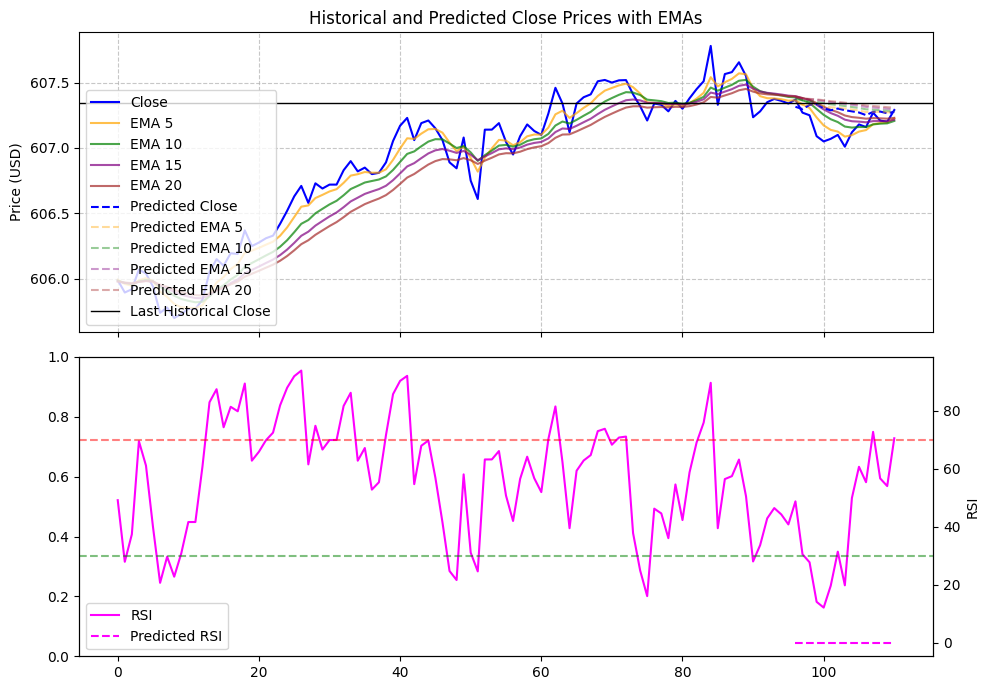

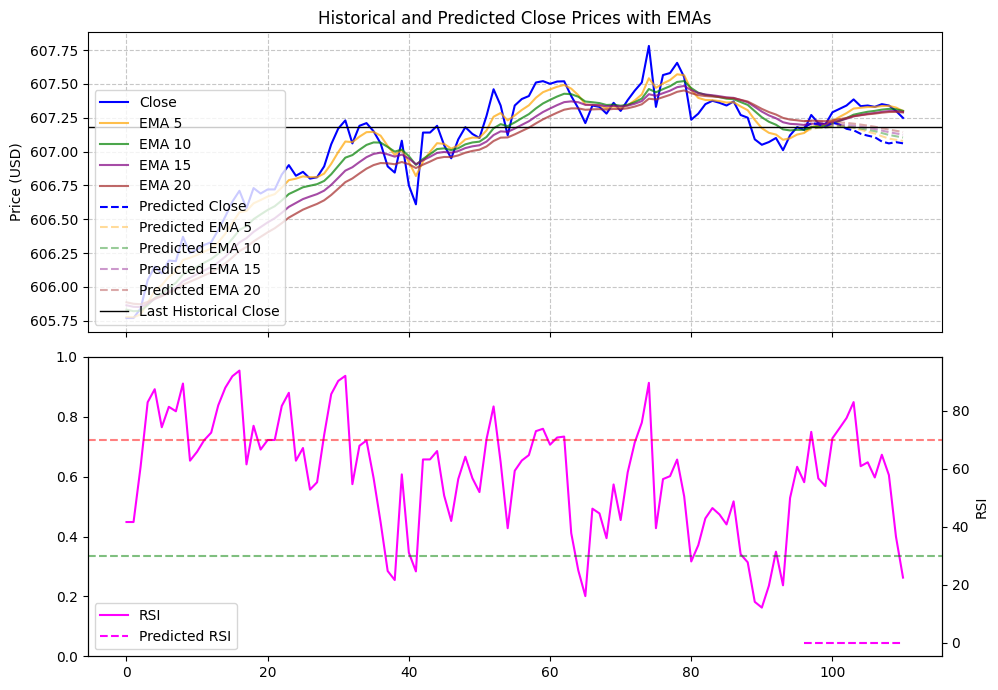

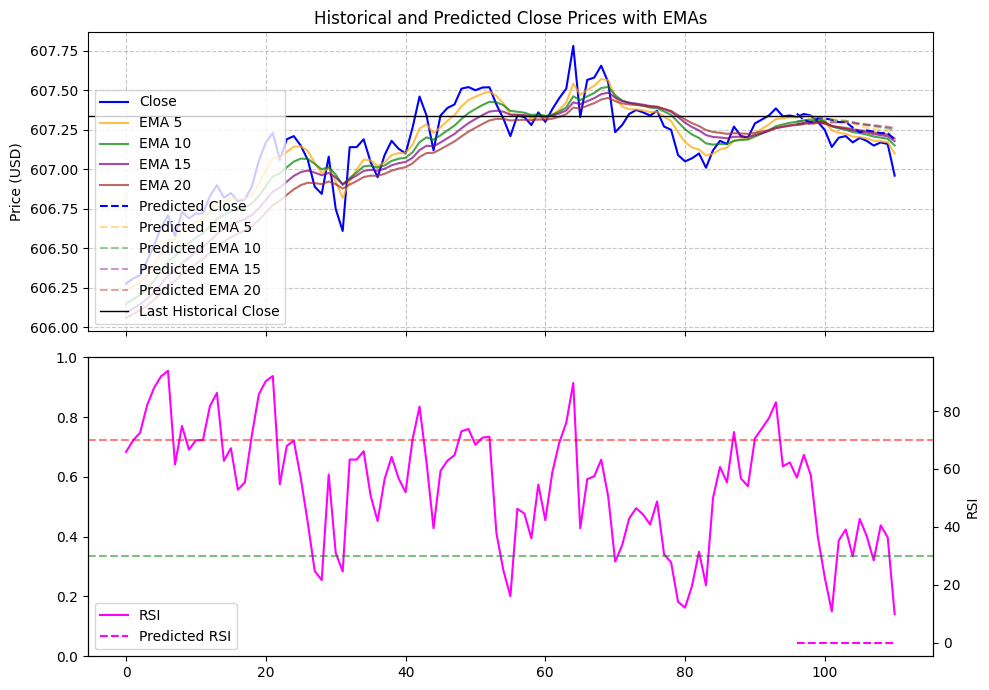

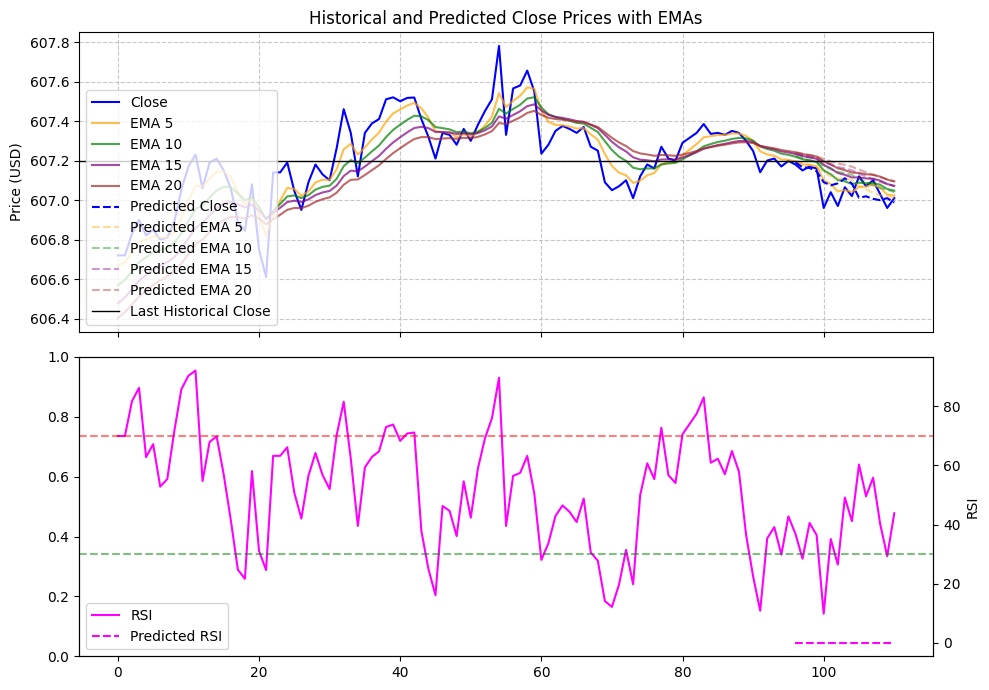

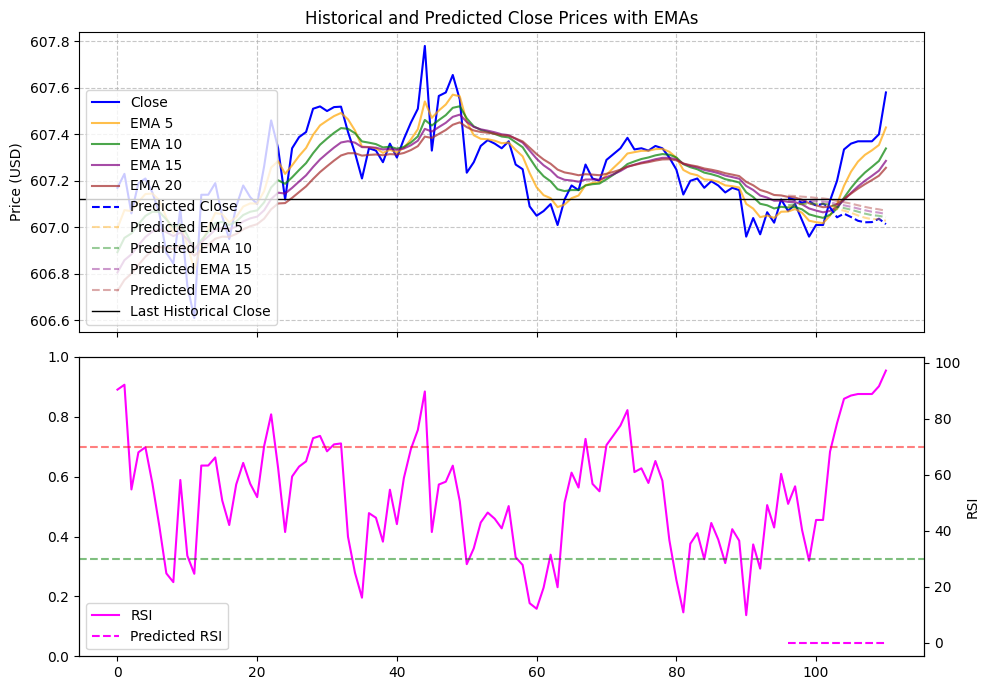

...

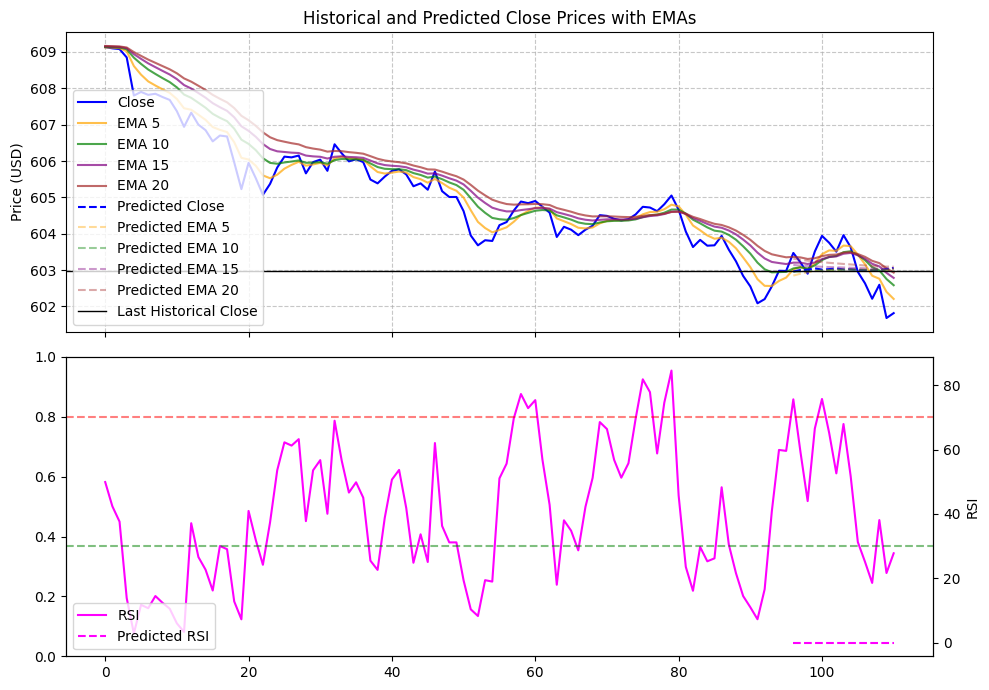

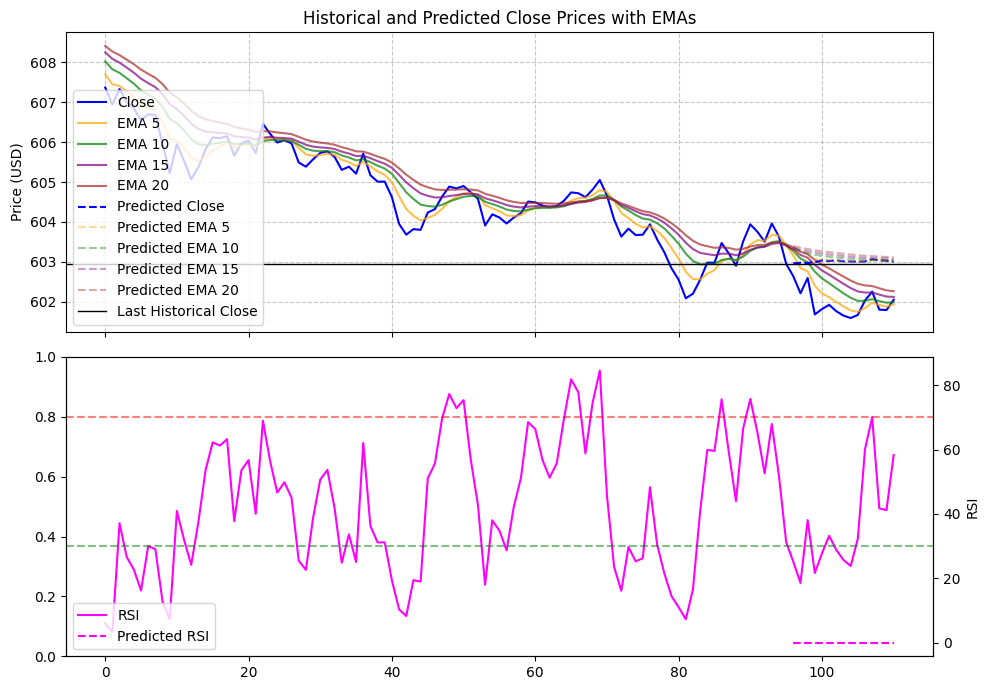

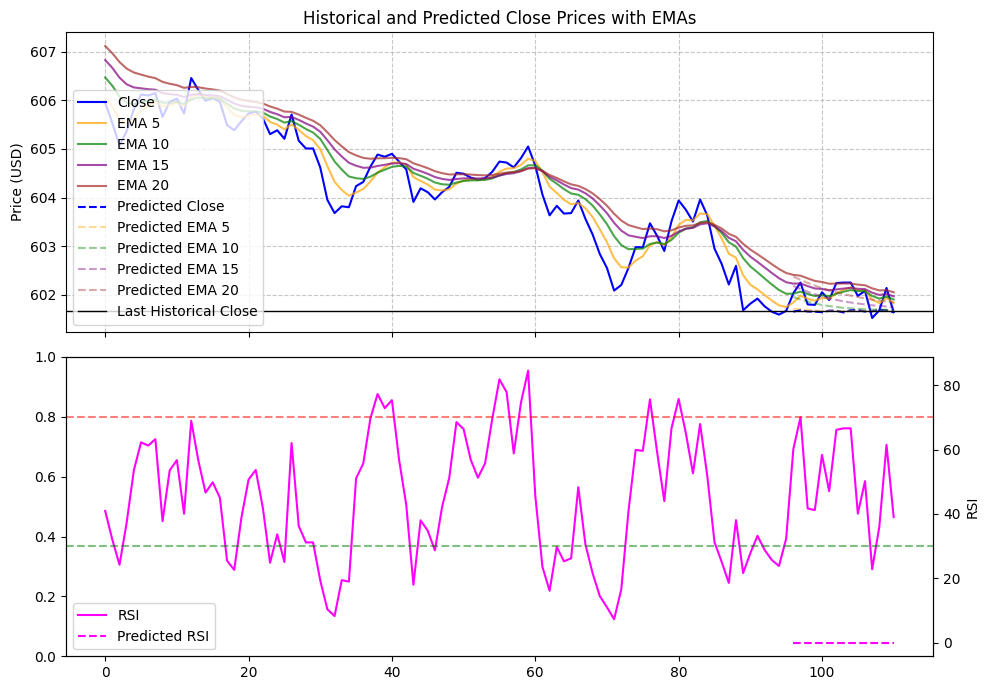

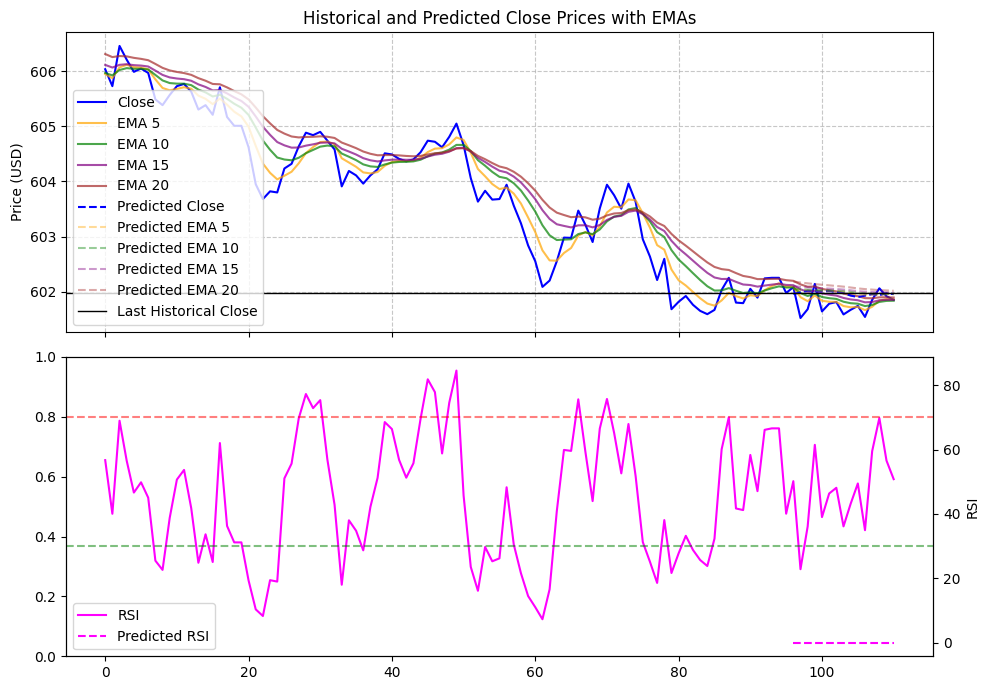

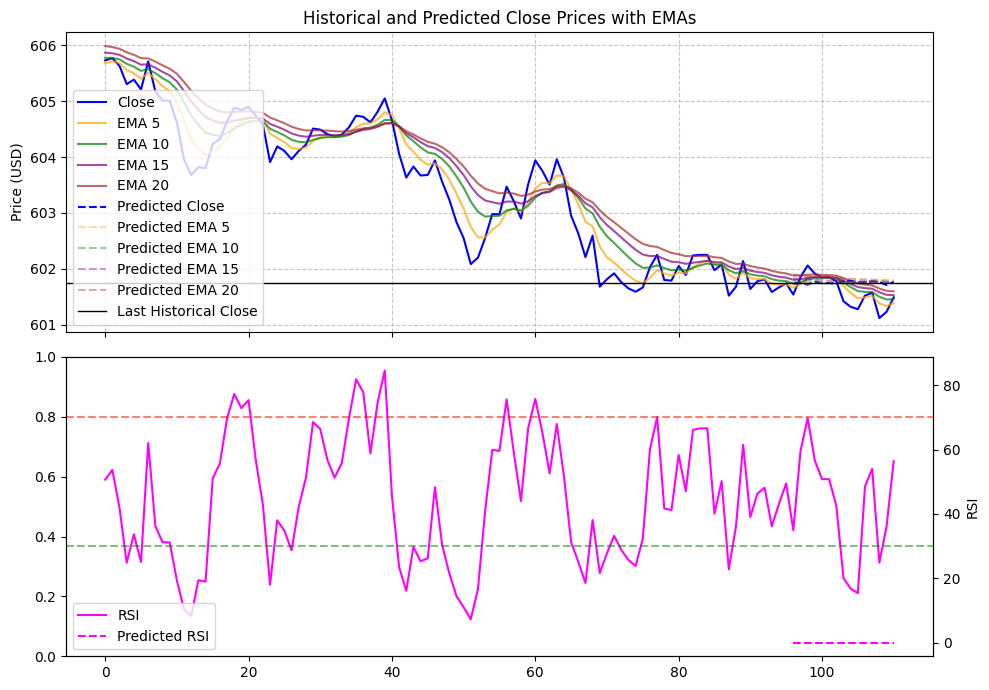

In [ ]:
import os

# Directory containing the JSON files
directory = '/content/drive/MyDrive/Colab Notebooks/futures.ai/backtest'

json_files = [f for f in os.listdir(directory) if f.endswith('.json')]
backtest_sample_size = len(json_files)
hit_count = 0

# Loop through all JSON files in the directory
for filename in json_files:
    # Construct the full file path
    file_path = os.path.join(directory, filename)
    # Convert JSON file to DataFrame
    backtest_df = pd.read_json(file_path)

    prediction_df = backtest_df.iloc[:-NUM_PREDICTIONS]
    prediction_df = prediction_df.copy()
    # print(prediction_df.tail())

    predicted_trends = predict_trends(prediction_df)
    # print(predicted_trends)

    # Prepare x-axis values (using index for simplicity)
    time_index = np.arange(len(backtest_df))

    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 7), sharex=True)

    # Historical close prices
    ax1.plot(time_index, backtest_df['close'], label='Close', color='blue')

    # Predicted close prices
    if PREDICTION_TIMESTEP_SPAN > 0:
        SPAN = PREDICTION_TIMESTEP_SPAN + 1
    else:
        SPAN = PREDICTION_TIMESTEP_SPAN
    future_index = np.arange(len(backtest_df) - (len(predicted_trends['close']) + PREDICTION_TIMESTEP_SPAN), len(backtest_df))
    # print(len(backtest_df))
    # print(len(predicted_trends['close']) + PREDICTION_TIMESTEP_SPAN + 1)
    # print(len(future_index))
    # print(future_index)

    # Historical EMAs
    ax1.plot(time_index, backtest_df['EMA_5'], label='EMA 5', color='orange', alpha=0.7)
    ax1.plot(time_index, backtest_df['EMA_10'], label='EMA 10', color='green', alpha=0.7)
    ax1.plot(time_index, backtest_df['EMA_15'], label='EMA 15', color='purple', alpha=0.7)
    ax1.plot(time_index, backtest_df['EMA_20'], label='EMA 20', color='brown', alpha=0.7)

    predicted_last_close_price = predicted_trends['close'][-1]
    # Extend predicted_trends to match future_index
    if PREDICTION_TIMESTEP_SPAN > 0:
        num_future_points = len(future_index)
        # Create new arrays for the extended predictions
        extended_close = np.full(num_future_points, predicted_last_close_price)
        # Plot the predicted close prices
        ax1.plot(future_index, extended_close, label='Predicted Close', color='blue', linestyle='--')
    else:
        # Plot the predicted close prices
        ax1.plot(future_index, predicted_trends['close'], label='Predicted Close', color='blue', linestyle='--')
        # Predicted EMAs (using lighter colors)
        ax1.plot(future_index, predicted_trends['EMA_5'], label='Predicted EMA 5', color='orange', alpha=0.4, linestyle='--')
        ax1.plot(future_index, predicted_trends['EMA_10'], label='Predicted EMA 10', color='green', alpha=0.4, linestyle='--')
        ax1.plot(future_index, predicted_trends['EMA_15'], label='Predicted EMA 15', color='purple', alpha=0.4, linestyle='--')
        ax1.plot(future_index, predicted_trends['EMA_20'], label='Predicted EMA 20', color='brown', alpha=0.4, linestyle='--')

    # Add a horizontal line for the last historical close price
    last_close_price = prediction_df['close'].iloc[-1]
    ax1.axhline(y=last_close_price, color='black', linestyle='-', linewidth=1, label='Last Historical Close')

    # Add a title and labels to the axes
    ax1.set_title('Historical and Predicted Close Prices with EMAs')
    ax1.set_ylabel('Price (USD)')
    ax1.grid(True, linestyle='--', alpha=0.7)
    ax1.legend(loc='lower left')

    # Add a second y-axis for RSI
    plt_rsi = ax2.twinx()
    plt_rsi.plot(time_index, backtest_df['RSI'], label='RSI', color='magenta', linestyle='-')
    plt_rsi.axhline(70, linestyle='--', alpha=0.5, color='red')
    plt_rsi.axhline(30, linestyle='--', alpha=0.5, color='green')

    # Predicted RSI (using a lighter color)
    if PREDICTION_TIMESTEP_SPAN <= 0:
        plt_rsi.plot(future_index, predicted_trends['RSI'], label='Predicted RSI', color='magenta', linestyle='--')
    plt_rsi.set_ylabel('RSI')
    plt_rsi.legend(loc='lower left')

    # Final adjustments and save the plot
    plt.tight_layout()
    plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/futures.ai/backtest/{filename}_plot.png')

    actual_close_price = backtest_df['close'].iloc[-1]
    # Determine the price direction for actual vs last close
    if actual_close_price > last_close_price:
        actual_direction = 'up'
    else:
        actual_direction = 'down'

    # Determine the price direction for actual vs predicted last close
    if predicted_last_close_price > last_close_price:
        predicted_direction = 'up'
    else:
        predicted_direction = 'down'

    # Increment hit_count if both directions are the same
    if actual_direction == predicted_direction:
        hit_count += 1

hit_rate = hit_count / backtest_sample_size
print(f'backtest_sample_size: {backtest_sample_size}, hit_count: {hit_count}, hit_rate: {hit_rate}')

## About the debugging printout

# Why are the following shapes torch.Size([1, 450]) and not torch.Size([1, 50, 9])?
# The shape torch.Size([1, 450]) arises after you concatenate the previous sequence with the new predictions. Here’s the relevant line of code:
# Current Sequence: Initially, current_sequence has the shape [1, 50, 9]. This means 1 batch, 50 time steps, and 9 features.
# Flattening: When you call .numpy().flatten(), it converts the tensor into a flat array, resulting in a shape of [450] (since 50 * 9 = 450).
# Concatenation: After you concatenate the flattened sequence with the predictions, you're left with a single-dimensional tensor of shape [450].

# What are the 'Prediction shape: (1, 1, 9)'?
# The shape (1, 1, 9) indicates that your model is producing one prediction for each feature in your output layer:
# Batch Size: The first 1 indicates that you're processing one batch.
# Time Steps: The second 1 indicates that you're predicting one time step ahead.
# Number of Features: The last 9 indicates that there are 9 features being predicted (which includes both the detrended features and the RSI).

# Why is 'All predictions shape: (9, 9)'?
# The shape (9, 9) for predictions_array indicates that you have made 9 predictions, each containing 9 features